<h1 style='text-align:center;border:10px double;border-color:gray;'>
    <br/>
     PROJET 5<br/>
    <br/>
    <font color = 'Navy'>"Segmentez des clients d'un site e-commerce"</font>
    <br/>
    <br/>
    
</h1>
<h4 style='text-align:left;border-color:gray;'>
    <br/>
    <font color = 'Navy'>* notebook de l'essais</font>
    <br/>
</h4>

 Dirigé par :   [Pouria Forouzesh](https://www.linkedin.com/in/pouria-forouzesh/)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.decomposition import PCA,TruncatedSVD, NMF
#from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score, davies_bouldin_score, adjusted_rand_score

from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer
from scipy.stats import f_oneway

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

warnings.filterwarnings('ignore')

In [2]:
df_init = pd.read_csv('df.csv', index_col='unique_id')
df_init.head()

,Recently,Frequency,num_product,MonetaryValue,review_score,payment_installments,num_category,weight_g,product_volume_cm3
unique_id,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,2692.069444,1,1,141.90,5.0,1,1,1500.0,7616.0
0000b849f77a49e4a4ce2b2a4ca5be3f,2763.819444,1,1,27.19,4.0,1,1,375.0,5148.0
0000f46a3911fa3c0805444483337064,12905.926111,1,1,86.22,3.0,1,1,1500.0,43750.0
0000f6ccb0745a6a4b88665a16c9f078,7722.515556,1,1,43.62,4.0,1,1,150.0,1045.0
0004aac84e0df4da2b147fca70cf8255,6931.248611,1,1,196.89,5.0,1,1,6050.0,528.0


### PCA (Analyse des Composantes Principales)

In [3]:
df = df_init.drop(['num_category', 'weight_g', 'product_volume_cm3', 'payment_installments'], axis=1)
print(df.isna().sum())
df.head()

Recently         0
Frequency        0
num_product      0
MonetaryValue    0
review_score     0
dtype: int64


,Recently,Frequency,num_product,MonetaryValue,review_score
unique_id,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,2692.069444,1,1,141.90,5.0
0000b849f77a49e4a4ce2b2a4ca5be3f,2763.819444,1,1,27.19,4.0
0000f46a3911fa3c0805444483337064,12905.926111,1,1,86.22,3.0
0000f6ccb0745a6a4b88665a16c9f078,7722.515556,1,1,43.62,4.0
0004aac84e0df4da2b147fca70cf8255,6931.248611,1,1,196.89,5.0


In [4]:
# r_labels = range(4, 0, -1)
# r_groups = pd.qcut(df['Recently'], q = 4, labels = r_labels)
# df['R'] = r_groups.values

# f_labels = range(1, 5)
# f_groups = pd.qcut(df['Frequency'], q=4, labels=f_labels, duplicates='drop')
# df['F'] = f_groups.values

# m_labels = range(1, 5)
# m_groups = pd.qcut(df['MonetaryValue'], q = 4, labels = m_labels)
# df['M'] = m_groups.values

# score_labels = range(1, 5)
# score_groups = pd.qcut(df['review_score'], q = 4, labels = score_labels)
# df['score'] = score_groups.values

# payment_labels = range(4, 0, -1)
# payment_groups = pd.qcut(df['payment_installments'], q = 4, labels = payment_labels)
# df['payment'] = payment_groups.values

# df

In [5]:
# Création d'un objet StandardScaler
scaler = StandardScaler()

# Ajustement du scaler aux données et transformation des données
data_scaled = scaler.fit_transform(df)

# Affichage des données transformées
#print("Données d'origine :\n", data)
print("Données transformées :\n", data_scaled)

Données transformées :
 [[-0.8422668  -0.1598373  -0.28216157 -0.1214501   0.65807263]
 [-0.82273972 -0.1598373  -0.28216157 -0.56364758 -0.12443203]
 [ 1.93747962 -0.1598373  -0.28216157 -0.33609185 -0.90693669]
 ...
 [ 2.14139489 -0.1598373  -0.28216157 -0.23493884  0.65807263]
 [-0.79119808 -0.1598373  -0.28216157 -0.15309896  0.65807263]
 [ 1.59150919 -0.1598373  -0.28216157 -0.39260493  0.65807263]]


In [6]:
# Création d'un objet PCA avec toutes les composantes principales
n_comp = 2
pca = PCA(n_components=n_comp)

# Ajustement du PCA aux données
pca.fit(data_scaled)

df_pca = pca.transform(data_scaled)

# Inertie expliquée par chaque composante principale
explained_variance = pca.explained_variance_

# Pourcentage d'inertie expliquée par chaque composante principale
explained_variance_ratio = pca.explained_variance_ratio_

# Composants principaux (vecteurs propres)
components = pca.components_

# Affichage des résultats
# print("Inertie expliquée par chaque composante principale :", explained_variance)
# print("Pourcentage d'inertie expliquée par chaque composante principale :", explained_variance_ratio)
# print("Composants principaux (vecteurs propres) :", components)


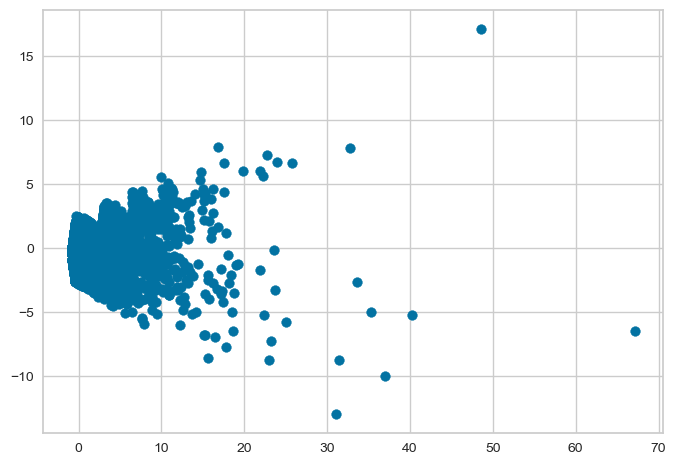

In [7]:
plt.scatter(x = df_pca[:,0], y = df_pca[:,1])

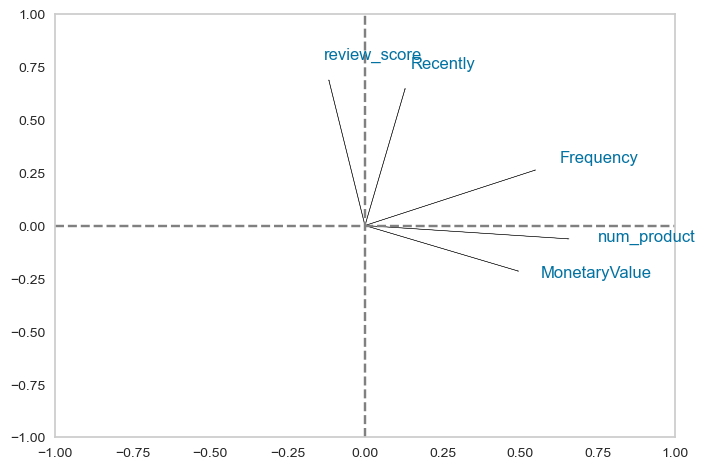

In [8]:
# Obtenez les charges factorielles
loadings = pca.components_.T

# Définissez les limites du plot
plt.xlim(-1, 1)
plt.ylim(-1, 1)

# Tracez les flèches des charges factorielles
for i, feature in enumerate(df.columns):
    plt.arrow(0, 0, loadings[i, 0], loadings[i, 1], color='black', alpha=0.8)
    plt.text(loadings[i, 0] * 1.15, loadings[i, 1] * 1.15, feature, color='b')

# Ajoutez des lignes de référence
plt.plot([-1, 1], [0, 0], color='gray', ls='--')
plt.plot([0, 0], [-1, 1], color='gray', ls='--')

# Ajoutez une grille pour une meilleure lisibilité
plt.grid()

# Affichez le plot
plt.show()


### Modélisation : K-Means

**Elbow method kMeans**

In [9]:
# wcss = {}
# for i in range(1,11):
#     kmeans = KMeans(n_clusters=  i, init = 'k-means++', max_iter= 300,  random_state = 42) #
#     kmeans.fit(df)
#     wcss[i] = kmeans.inertia_
    

# plt.figure(figsize = (8,6))
# sns.pointplot(x = list(wcss.keys()), y = list(wcss.values()))

# # Tracé de la ligne verticale
# plt.axvline(x=3, color='r', linestyle='--')

# plt.show();

**Silhouette method kMeans**

In [10]:
# range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]
# silhouette_avg = []
# for num_clusters in range_n_clusters:
 
#     # initialise kmeans
#     kmeans1 = KMeans(n_clusters=num_clusters, random_state = 42)
#     kmeans1.fit(data_scaled)
#     cluster_labels = kmeans1.labels_
 
#    # silhouette score
#     silhouette_avg.append(silhouette_score(data_scaled, cluster_labels))

# print("Silhouette Score:" , silhouette_avg)
# print("Silhouette Score:", silhouette_score(data_scaled, cluster_labels))
    
# plt.figure(figsize = (10,8))    
# plt.plot(range_n_clusters,silhouette_avg, 'bx-')
# plt.xlabel('Values of K') 
# plt.ylabel('Silhouette score') 
# plt.title('Silhouette analysis For Optimal k')

# # Tracé de la ligne verticale
# plt.axvline(x=7, color='r', linestyle='--')

# plt.show()

In [11]:
# plt.figure(figsize = (6,20))
# model = KMeans(n_clusters=7, random_state=42)
# visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

# visualizer.fit(data_scaled)
# visualizer.show()


##### 4 Cluster

In [12]:
# Créer une instance de l'algorithme K-means avec 3 clusters
kmeans_4 = KMeans(n_clusters=4, random_state=42)

# Effectuer le clustering sur les données
kmeans_4.fit(data_scaled)

# Obtenir les labels de cluster assignés à chaque point de données
labels_4 = kmeans_4.labels_

# Obtenir les coordonnées des centres de cluster
centroids = kmeans_4.cluster_centers_

# # Afficher les résultats
# print("Labels de cluster:")
# print(labels_4)
# print("Coordonnées des centres de cluster:")
# print(centroids)

In [13]:
df_kmeans_4 = pd.DataFrame(data_scaled, columns = df.columns)
df_kmeans_4['km_clusters'] = labels_4
df_kmeans_4

,Recently,Frequency,num_product,MonetaryValue,review_score,km_clusters
0,-0.842267,-0.159837,-0.282162,-0.121450,0.658073,1
1,-0.822740,-0.159837,-0.282162,-0.563648,-0.124432,1
2,1.937480,-0.159837,-0.282162,-0.336092,-0.906937,2
3,0.526791,-0.159837,-0.282162,-0.500311,-0.124432,2
4,0.311445,-0.159837,-0.282162,0.090532,0.658073,2
...,...,...,...,...,...,...
93344,1.349646,-0.159837,0.895549,7.301269,0.658073,2
93345,0.141519,-0.159837,-0.282162,-0.342414,-0.124432,2
93346,2.141395,-0.159837,-0.282162,-0.234939,0.658073,2
93347,-0.791198,-0.159837,-0.282162,-0.153099,0.658073,1


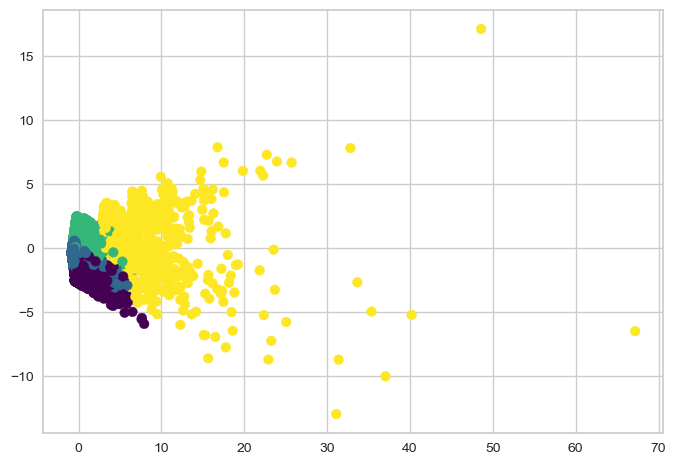

In [14]:
plt.scatter(x = df_pca[:,0], y = df_pca[:,1], c = df_kmeans_4['km_clusters'], cmap='viridis')

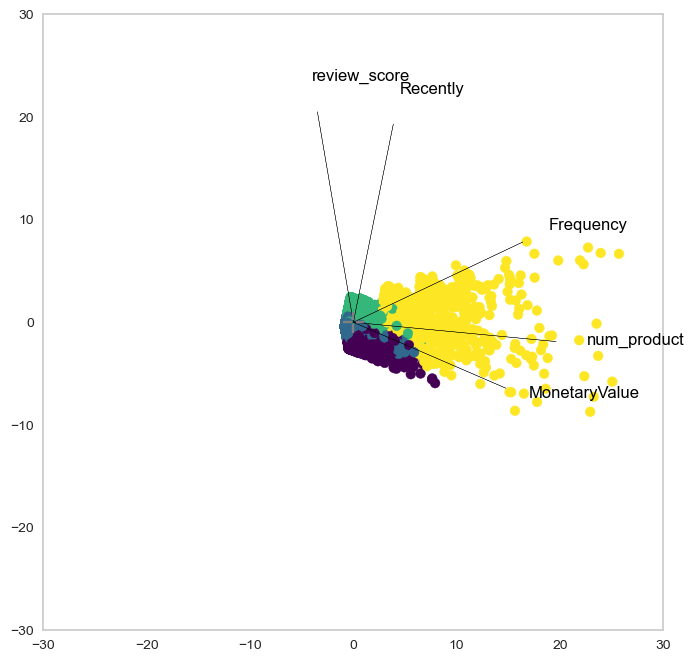

In [15]:
# Tracer les points scatter avec les clusters
plt.figure(figsize=(8, 8))
plt.scatter(x=df_pca[:, 0], y=df_pca[:, 1], c=df_kmeans_4['km_clusters'], cmap='viridis')

# Tracer le cercle de corrélation
plt.xlim(-30, 30)
plt.ylim(-30, 30)

for i, feature in enumerate(df.columns):
    plt.arrow(0, 0, loadings[i, 0]*30, loadings[i, 1]*30, color='black', alpha=0.8)
    plt.text(loadings[i, 0] * 1.15 *30, loadings[i, 1] * 1.15 *30, feature, color='black')

plt.plot([-1, 1], [0, 0], color='gray', ls='--')
plt.plot([0, 0], [-1, 1], color='gray', ls='--')

plt.grid()
plt.show()


##### 7 Cluster

In [16]:
# Créer une instance de l'algorithme K-means avec 3 clusters
kmeans_7 = KMeans(n_clusters=7, random_state=42)

# Effectuer le clustering sur les données
kmeans_7.fit(data_scaled)

# Obtenir les labels de cluster assignés à chaque point de données
labels_7 = kmeans_7.labels_

# Obtenir les coordonnées des centres de cluster
centroids = kmeans_7.cluster_centers_

# Afficher les résultats
# print("Labels de cluster:")
# print(labels_7)
# print("Coordonnées des centres de cluster:")
# print(centroids)

In [17]:
df_kmeans_7 = pd.DataFrame(data_scaled, columns = df.columns)
df_kmeans_7['km_clusters'] = labels_7

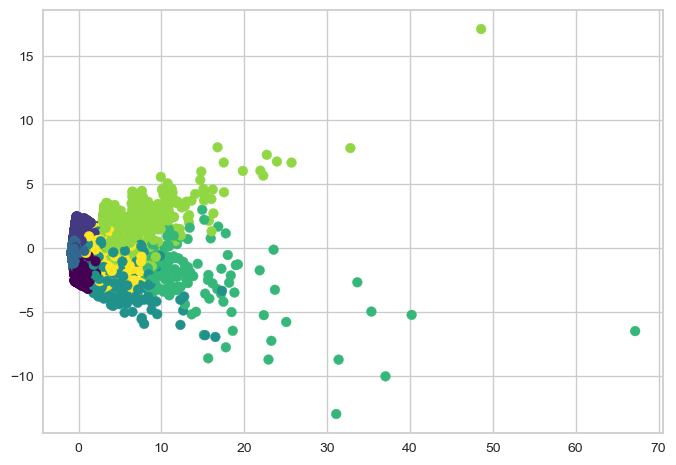

In [18]:
# plt.scatter(x = df_pca[:,0], y = df_pca[:,1], c = df_kmeans_7['km_clusters'],  )
plt.scatter(x=df_pca[:, 0], y=df_pca[:, 1], c=df_kmeans_7['km_clusters'], cmap='viridis')


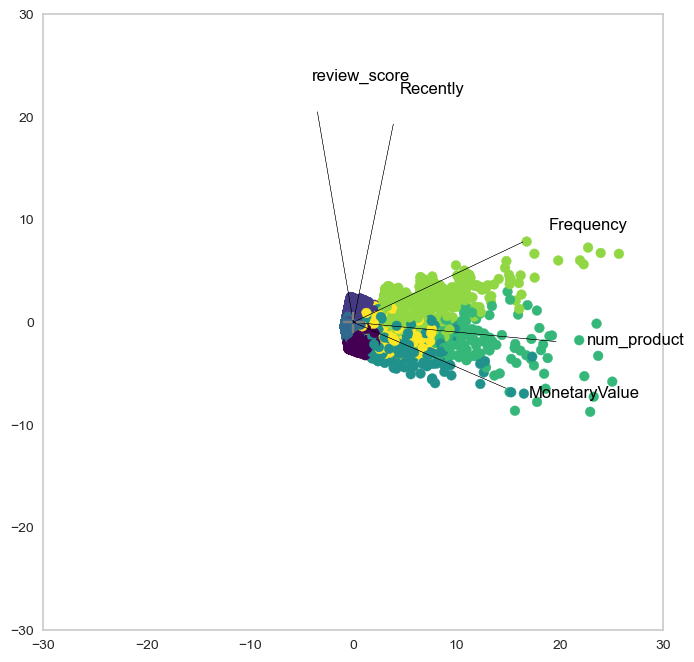

In [19]:
# Tracer les points scatter avec les clusters
plt.figure(figsize=(8, 8))
plt.scatter(x=df_pca[:, 0], y=df_pca[:, 1], c=df_kmeans_7['km_clusters'], cmap='viridis')

# Tracer le cercle de corrélation
plt.xlim(-30, 30)
plt.ylim(-30, 30)

for i, feature in enumerate(df.columns):
    plt.arrow(0, 0, loadings[i, 0]*30, loadings[i, 1]*30, color='black', alpha=0.8)
    plt.text(loadings[i, 0] * 1.15 *30, loadings[i, 1] * 1.15 *30, feature, color='black')

plt.plot([-1, 1], [0, 0], color='gray', ls='--')
plt.plot([0, 0], [-1, 1], color='gray', ls='--')

plt.grid()
plt.show()

In [20]:
kmean_analysis = df_kmeans_7.groupby('km_clusters').mean()
kmean_analysis

,Recently,Frequency,num_product,MonetaryValue,review_score
km_clusters,,,,,
0,-0.067903,-0.159837,-0.054861,-0.087263,-1.896643
1,1.002121,-0.159837,-0.174052,-0.139603,0.379246
2,-0.765040,-0.159837,-0.189554,-0.147903,0.431879
3,-0.034188,-0.103471,0.080211,4.757076,0.006309
4,0.273057,1.706411,14.424860,7.782289,-0.514407
5,0.446197,5.163087,1.792791,0.545744,0.043798
6,-0.005717,-0.157689,3.181662,0.681406,-0.236359


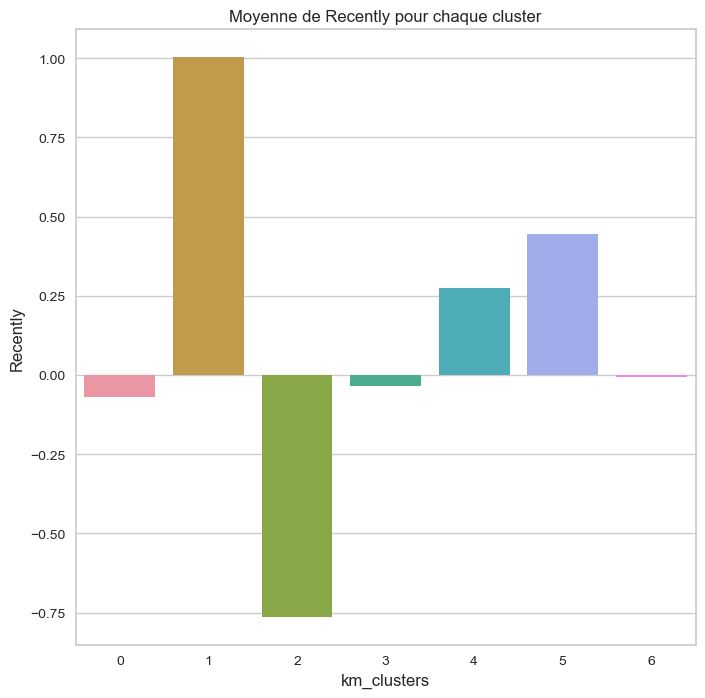

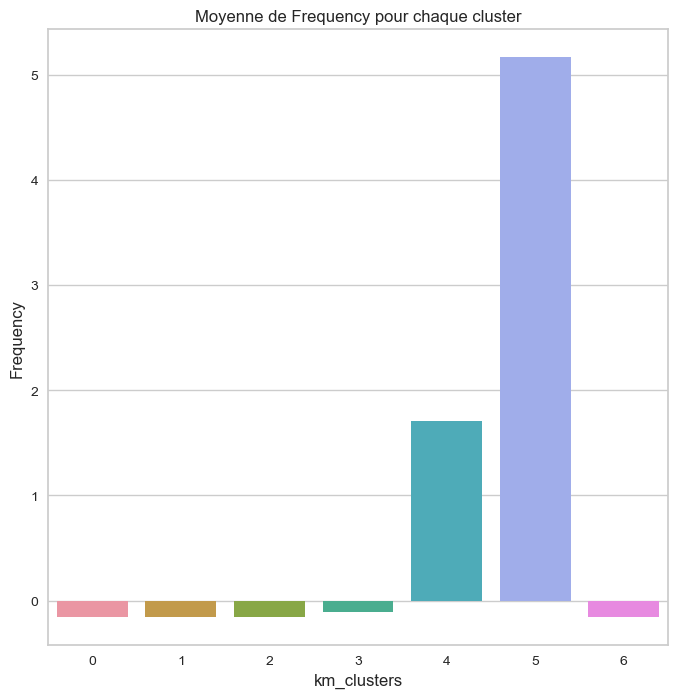

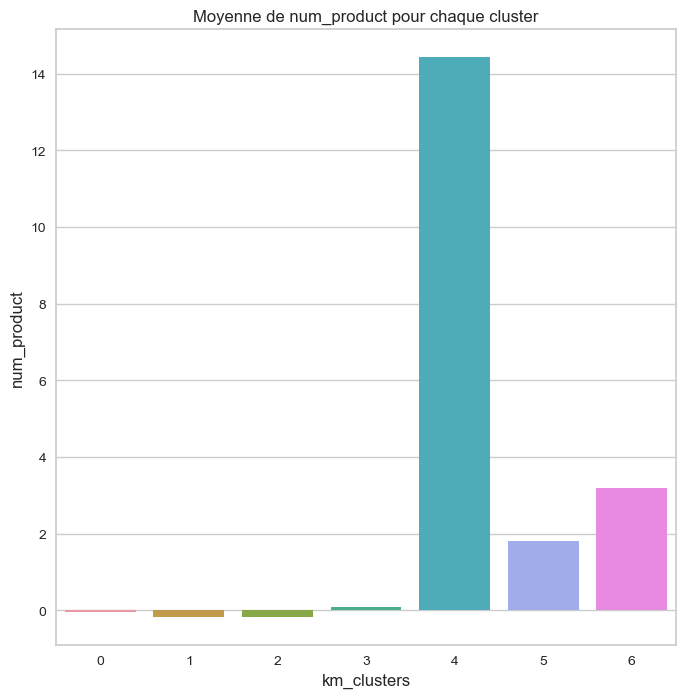

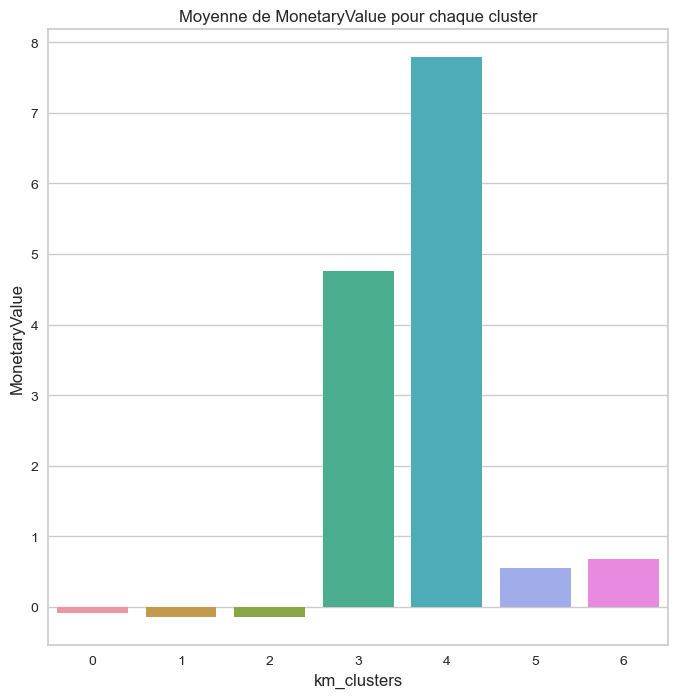

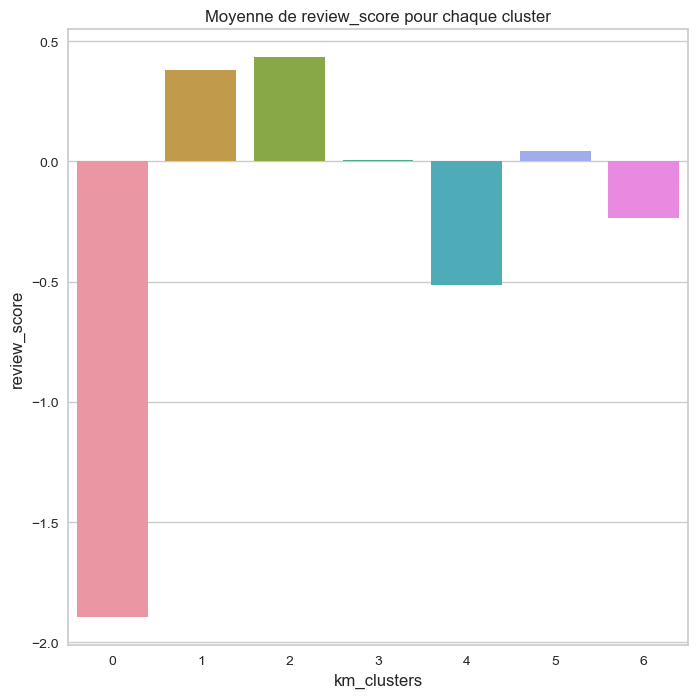

In [21]:
for column in kmean_analysis.columns:
    try:
        plt.figure(figsize=(8,8))
        titre = 'Moyenne de ' + str(column) + ' pour chaque cluster' 
        plt.title(titre)
        sns.barplot(x = kmean_analysis.index,
                    y = column,
                    data = kmean_analysis 
                    )
        plt.show()
    except:
        print('Erreur colonne : ', column)

**Analyse de la variance (ANOVA)**

In [22]:
# anova de Recently
groupe1_Recently = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['Recently'])
groupe2_Recently = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['Recently'])
groupe3_Recently = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['Recently'])
groupe4_Recently = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['Recently'])
groupe5_Recently = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['Recently'])
groupe6_Recently = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['Recently'])
groupe7_Recently = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['Recently'])

# ANOVA à un facteur
statistique_Recently, p_value_Recently = f_oneway(groupe1_Recently, groupe2_Recently, groupe3_Recently,
                               groupe4_Recently, groupe5_Recently, groupe6_Recently,
                               groupe7_Recently)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_Recently)
print("Valeur de p :", p_value_Recently)

Statistique de l'ANOVA : 22693.57860376508
Valeur de p : 0.0


In [23]:
# anova de Frequency
groupe1_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['Frequency'])
groupe2_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['Frequency'])
groupe3_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['Frequency'])
groupe4_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['Frequency'])
groupe5_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['Frequency'])
groupe6_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['Frequency'])
groupe7_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['Frequency'])

# ANOVA à un facteur
statistique_Frequency, p_value_Frequency = f_oneway(groupe1_Frequency, groupe2_Frequency, groupe3_Frequency,
                               groupe4_Frequency, groupe5_Frequency, groupe6_Frequency,
                               groupe7_Frequency)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_Frequency)
print("Valeur de p :", p_value_Frequency)

Statistique de l'ANOVA : 66910.0303042281
Valeur de p : 0.0


In [24]:
# anova de MonetaryValue
groupe1_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['MonetaryValue'])
groupe2_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['MonetaryValue'])
groupe3_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['MonetaryValue'])
groupe4_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['MonetaryValue'])
groupe5_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['MonetaryValue'])
groupe6_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['MonetaryValue'])
groupe7_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['MonetaryValue'])

# ANOVA à un facteur
statistique_MonetaryValue, p_value_MonetaryValue = f_oneway(groupe1_MonetaryValue, groupe2_MonetaryValue, groupe3_MonetaryValue,
                               groupe4_MonetaryValue, groupe5_MonetaryValue, groupe6_MonetaryValue,
                               groupe7_MonetaryValue)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_MonetaryValue)
print("Valeur de p :", p_value_MonetaryValue)

Statistique de l'ANOVA : 16037.376787288847
Valeur de p : 0.0


In [25]:
# anova de num_product
groupe1_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['num_product'])
groupe2_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['num_product'])
groupe3_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['num_product'])
groupe4_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['num_product'])
groupe5_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['num_product'])
groupe6_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['num_product'])
groupe7_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['num_product'])

# ANOVA à un facteur
statistique_num_product, p_value_num_product = f_oneway(groupe1_num_product, groupe2_num_product, groupe3_num_product,
                               groupe4_num_product, groupe5_num_product, groupe6_num_product,
                               groupe7_num_product)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_num_product)
print("Valeur de p :", p_value_num_product)

Statistique de l'ANOVA : 27207.680313599678
Valeur de p : 0.0


In [26]:
# anova de num_product
groupe1_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['review_score'])
groupe2_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['review_score'])
groupe3_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['review_score'])
groupe4_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['review_score'])
groupe5_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['review_score'])
groupe6_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['review_score'])
groupe7_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['review_score'])

# ANOVA à un facteur
statistique_review_score, p_value_review_score = f_oneway(groupe1_review_score, groupe2_review_score, groupe3_review_score,
                               groupe4_num_product, groupe5_review_score, groupe6_review_score,
                               groupe7_num_product)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_review_score)
print("Valeur de p :", p_value_review_score)

Statistique de l'ANOVA : 50042.44744247045
Valeur de p : 0.0


**Radar chart**

In [27]:
kmean_analysis.head()

,Recently,Frequency,num_product,MonetaryValue,review_score
km_clusters,,,,,
0,-0.067903,-0.159837,-0.054861,-0.087263,-1.896643
1,1.002121,-0.159837,-0.174052,-0.139603,0.379246
2,-0.765040,-0.159837,-0.189554,-0.147903,0.431879
3,-0.034188,-0.103471,0.080211,4.757076,0.006309
4,0.273057,1.706411,14.424860,7.782289,-0.514407


In [28]:
kmean_cluster_0 = kmean_analysis.iloc[0,:]
kmean_radar_0 = list(kmean_cluster_0.values)

kmean_cluster_1 = kmean_analysis.iloc[1,:]
kmean_radar_1 = list(kmean_cluster_1.values)

kmean_cluster_2 = kmean_analysis.iloc[2,:]
kmean_radar_2 = list(kmean_cluster_2.values)

kmean_cluster_3 = kmean_analysis.iloc[3,:]
kmean_radar_3 = list(kmean_cluster_3.values)

kmean_cluster_4 = kmean_analysis.iloc[4,:]
kmean_radar_4 = list(kmean_cluster_4.values)

kmean_cluster_5 = kmean_analysis.iloc[5,:]
kmean_radar_5 = list(kmean_cluster_5.values)

kmean_cluster_6 = kmean_analysis.iloc[6,:]
kmean_radar_6 = list(kmean_cluster_6.values)

In [29]:
df_0 = pd.DataFrame(dict(
    r=kmean_radar_0,
    theta=['Recently','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_0, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 0')

fig.show()

df_1 = pd.DataFrame(dict(
    r=kmean_radar_1,
    theta=['Recently','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_1, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 1')

fig.show()

df_2 = pd.DataFrame(dict(
    r=kmean_radar_2,
    theta=['Recently','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_2, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 2')

fig.show()

df_3 = pd.DataFrame(dict(
    r=kmean_radar_3,
    theta=['Recently','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_3, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 3')

fig.show()

df_4 = pd.DataFrame(dict(
    r=kmean_radar_4,
    theta=['Recently','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_4, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 4')

fig.show()


df_5 = pd.DataFrame(dict(
    r=kmean_radar_5,
    theta=['Recently','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_5, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 5')

fig.show()


df_6 = pd.DataFrame(dict(
    r=kmean_radar_6,
    theta=['Recently','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_6, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 6')

fig.show()

In [30]:
import plotly.graph_objects as go
import pandas as pd

# Données pour chaque label KMeans et chaque variable
data = [
    (kmean_radar_0, 'KMeans Label 0'),
    (kmean_radar_1, 'KMeans Label 1'),
    (kmean_radar_2, 'KMeans Label 2'),
    (kmean_radar_3, 'KMeans Label 3'),
    (kmean_radar_4, 'KMeans Label 4'),
    (kmean_radar_5, 'KMeans Label 5'),
    (kmean_radar_6, 'KMeans Label 6')
]

fig = go.Figure()

# Ajout des sous-graphiques pour chaque label KMeans
for r, label in data:
    df_radar = pd.DataFrame(dict(r=r, theta=['Recently','Frequency','num_product', 'MonetaryValue', 'review_score']))
    fig.add_trace(go.Scatterpolar(r=df_radar['r'], theta=df_radar['theta'], fill='toself', name=label))

# Mise en forme du layout
fig.update_layout(
    polar=dict(
        radialaxis=dict(range=[0, max(max(data[0][0]), max(data[1][0]), max(data[2][0]), max(data[3][0]), max(data[4][0]), max(data[5][0]), max(data[6][0]))])
    ),
    showlegend=True
)

# Affichage du graphique
fig.show()


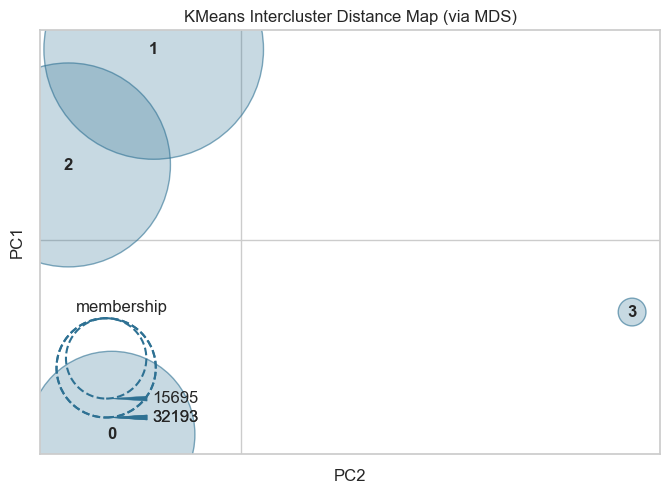

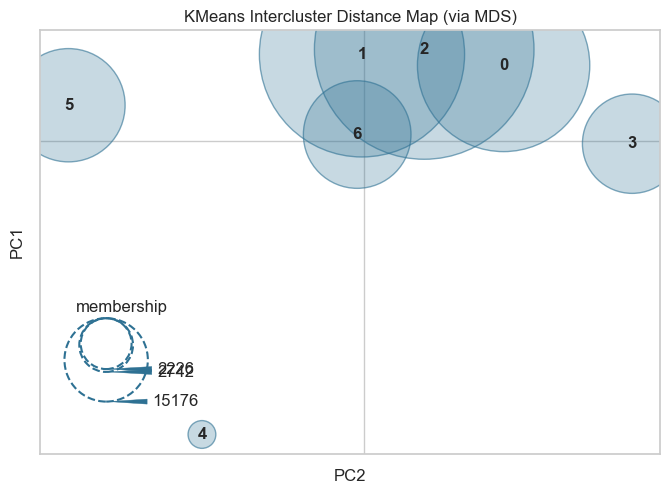

InterclusterDistance(ax=<Axes: title={'center': 'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>,
                     estimator=KMeans(n_clusters=7, random_state=42))

In [31]:
from yellowbrick.cluster import intercluster_distance

intercluster_distance(KMeans(4, random_state=42), data_scaled)
intercluster_distance(KMeans(7, random_state=42), data_scaled)

In [32]:
df_km_normalized_4 = pd.DataFrame(data_scaled, columns=['Recency', 'Frequency','num_product','MonetaryValue', 'review_score'])

#df_km_normalized['ID'] = df.index
df_km_normalized_4["Cluster"] = kmeans_4.labels_

df_km_melt_4 = pd.melt(df_km_normalized_4.reset_index(),id_vars=[ "Cluster"],
                      value_vars=["Recency", "Frequency", "num_product",
                                  "MonetaryValue", "review_score"
                                   ],
                      var_name="Features",
                      value_name="Value")

df_km_melt_4['Value(log)'] = np.log(df_km_melt_4['Value'])
df_km_melt_4.head(5)

,Cluster,Features,Value,Value(log)
0,1,Recency,-0.842267,NaN
1,1,Recency,-0.822740,NaN
2,2,Recency,1.937480,0.661388
3,2,Recency,0.526791,-0.640951
4,2,Recency,0.311445,-1.166534


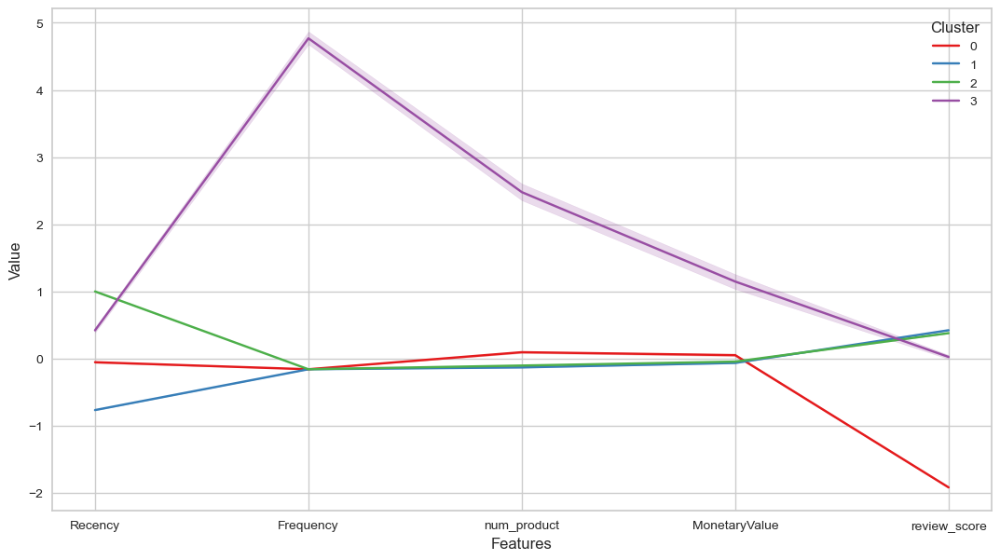

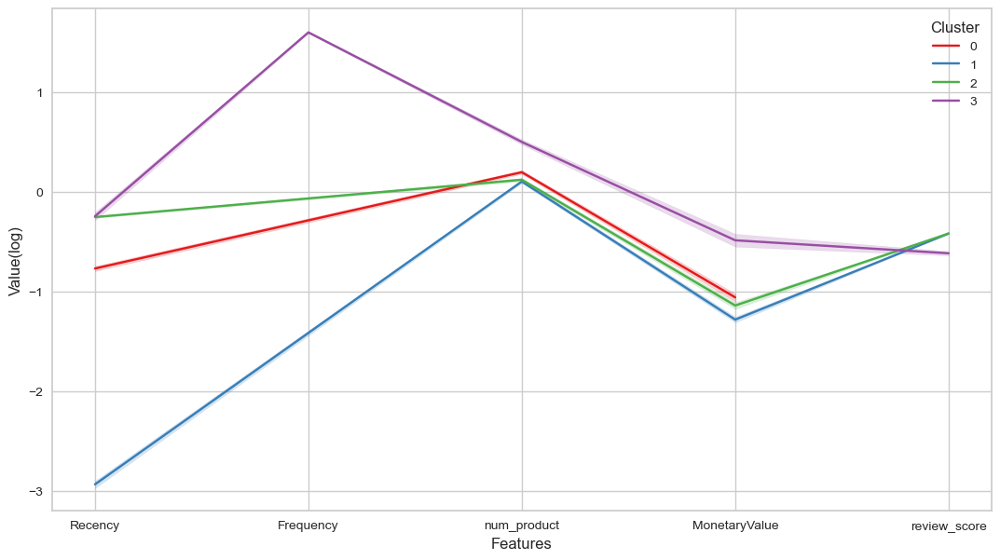

In [33]:
fig, ax = plt.subplots(figsize=(13, 7))
palette = sns.color_palette("Set1", len(df_km_melt_4['Cluster'].unique()))
sns.lineplot(x="Features", y="Value", hue="Cluster", data=df_km_melt_4, palette=palette)
plt.show()

fig, ax = plt.subplots(figsize=(13, 7))
sns.lineplot(x="Features", y="Value(log)", hue="Cluster", data=df_km_melt_4, palette=palette)
plt.show()


In [34]:
df_km_normalized_7 = pd.DataFrame(data_scaled, columns=['Recency', 'Frequency','num_product','MonetaryValue', 'review_score'])

#df_km_normalized['ID'] = df.index
df_km_normalized_7["Cluster"] = kmeans_7.labels_

df_km_melt_7 = pd.melt(df_km_normalized_7.reset_index(),id_vars=[ "Cluster"],
                      value_vars=["Recency", "Frequency", "num_product",
                                  "MonetaryValue", "review_score"
                                   ],
                      var_name="Features",
                      value_name="Value")
df_km_melt_7['Value(log)'] = np.log(df_km_melt_7['Value'])


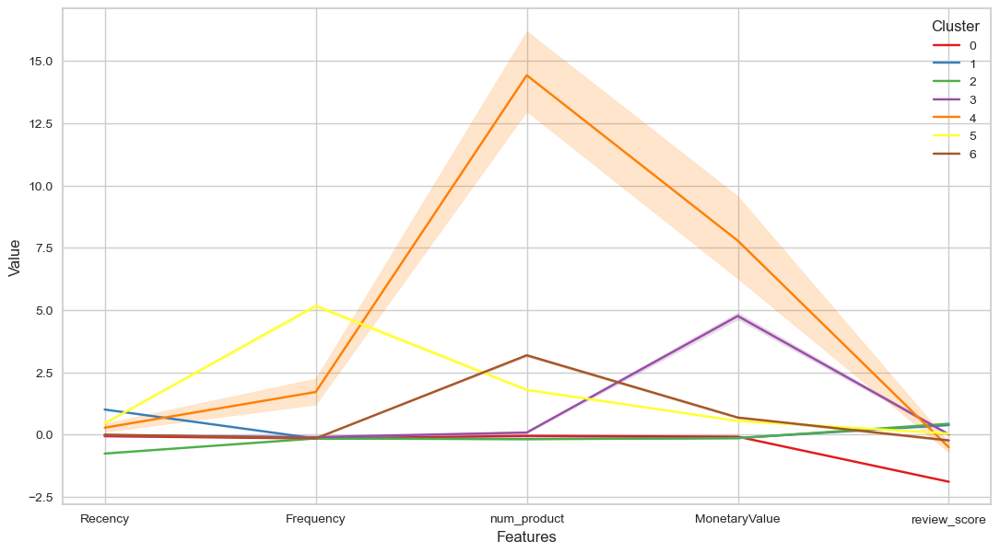

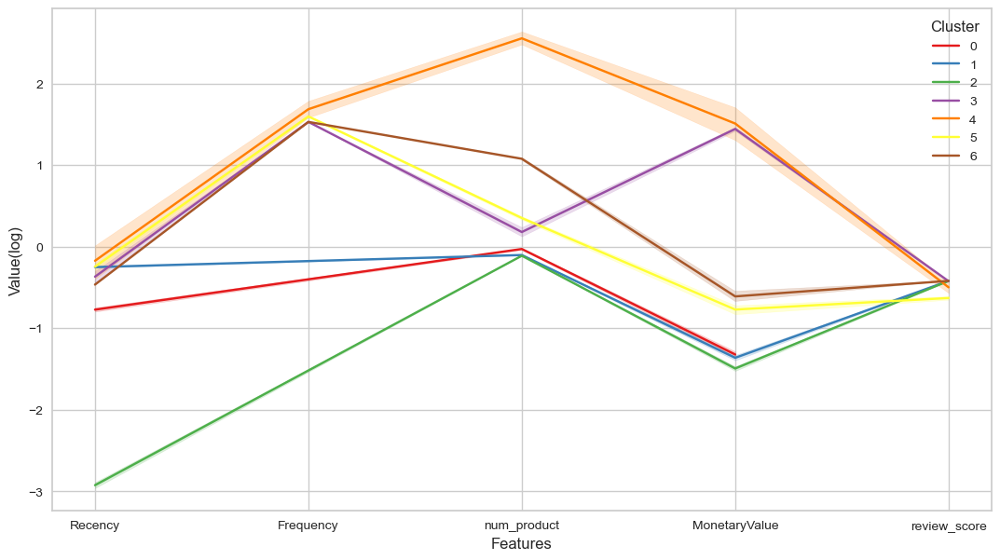

In [35]:
fig, ax = plt.subplots(figsize=(13, 7))
palette = sns.color_palette("Set1", len(df_km_melt_7['Cluster'].unique()))
sns.lineplot(x="Features", y="Value", hue="Cluster", data=df_km_melt_7, palette=palette)
plt.show()

fig, ax = plt.subplots(figsize=(13, 7))
sns.lineplot(x="Features", y="Value(log)", hue="Cluster", data=df_km_melt_7, palette=palette)
plt.show()


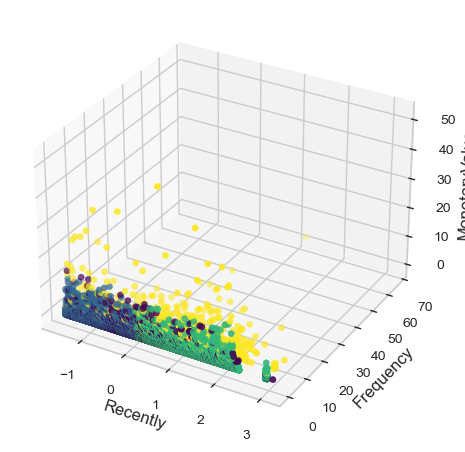

In [45]:
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Créer une figure en 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Tracer les points en 3D avec coloration selon "km_clusters"
ax.scatter(Recently, Frequency, MonetaryValue, c=df_kmeans_4['km_clusters'], cmap='viridis')

# Ajouter des labels aux axes
ax.set_xlabel('Recently')
ax.set_ylabel('Frequency')
ax.set_zlabel('MonetaryValue')

# Afficher une légende pour les couleurs
#legend_labels = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3']
#ax.legend(legend_labels)

# Afficher le graphique
plt.show()


In [46]:
import plotly.graph_objects as go

# Données d'exemple
km_clusters = df_kmeans_4['km_clusters']

# Créer une figure en 3D
fig = go.Figure(data=go.Scatter3d(
    x=Recently,
    y=Frequency,
    z=MonetaryValue,
    mode='markers',
    marker=dict(
        size=8,
        color=km_clusters,
        colorscale='viridis',
        opacity=0.8
    )
))

# Définir les labels des axes
fig.update_layout(scene=dict(
    xaxis_title='Recently',
    yaxis_title='Frequency',
    zaxis_title='MonetaryValue'
))

# Afficher le graphique
fig.show()
